In [284]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from numpy import expand_dims
import tensorflow as tf
from matplotlib import pyplot as plt
from PIL import Image, ImageFont, ImageDraw
import cv2
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import load_img
from keras.preprocessing.image import save_img
from keras.preprocessing.image import img_to_array

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os

#for dirname, _, filenames in os.walk('/kaggle/input'):
    #for filename in filenames:
        #print(os.path.join(dirname, filename))
        

In [76]:
import json

with open("train.json", 'r') as file:
    train_data = json.load(file)
    
with open("val.json", 'r') as file:
    test_data = json.load(file)
    
print("%.1000s" % train_data)

{'annotations': [{'area': 2304645, 'iscrowd': 0, 'id': 1, 'image_id': 10, 'category_id': 4, 'bbox': [704, 620, 1401, 1645]}, {'area': 55769, 'iscrowd': 0, 'id': 2, 'image_id': 1000, 'category_id': 1, 'bbox': [321, 332, 217, 257]}, {'area': 17108, 'iscrowd': 0, 'id': 3, 'image_id': 10003, 'category_id': 2, 'bbox': [220, 758, 188, 91]}, {'area': 117909, 'iscrowd': 0, 'id': 4, 'image_id': 10003, 'category_id': 5, 'bbox': [150, 397, 297, 397]}, {'area': 105925, 'iscrowd': 0, 'id': 5, 'image_id': 10003, 'category_id': 1, 'bbox': [85, 207, 475, 223]}, {'area': 3314505, 'iscrowd': 0, 'id': 6, 'image_id': 10005, 'category_id': 4, 'bbox': [1971, 2059, 1483, 2235]}, {'area': 198360, 'iscrowd': 0, 'id': 7, 'image_id': 10005, 'category_id': 2, 'bbox': [1524, 3739, 380, 522]}, {'area': 922870, 'iscrowd': 0, 'id': 8, 'image_id': 10005, 'category_id': 4, 'bbox': [1280, 2736, 806, 1145]}, {'area': 708070, 'iscrowd': 0, 'id': 9, 'image_id': 10005, 'category_id': 2, 'bbox': [408, 3708, 785, 902]}, {'are

In [77]:
train_annotations = train_data['annotations']
train_images = train_data['images']
categories = train_data['categories']

print(train_annotations[0])
print(train_images[0])
print(categories)

print(len(train_annotations))

{'area': 2304645, 'iscrowd': 0, 'id': 1, 'image_id': 10, 'category_id': 4, 'bbox': [704, 620, 1401, 1645]}
{'file_name': '10.jpg', 'id': 10}
[{'id': 1, 'name': 'tops'}, {'id': 2, 'name': 'trousers'}, {'id': 3, 'name': 'outerwear'}, {'id': 4, 'name': 'dresses'}, {'id': 5, 'name': 'skirts'}]
13317


In [78]:
test_annotations = test_data['annotations']
test_images = test_data['images']

print(test_annotations[0])
print(test_images[0])

print(len(test_annotations))

{'area': 996743, 'iscrowd': 0, 'id': 1, 'image_id': 1, 'category_id': 4, 'bbox': [523, 55, 869, 1147]}
{'file_name': '1.jpg', 'id': 1}
2458


In [79]:
category_mapping = {}

for category_item in categories:
    category_mapping[category_item['id']] = category_item['name']

In [80]:
train_id_to_path_mapping = {}

for image_item in train_images:
    train_id_to_path_mapping[image_item['id']] = image_item['file_name']
    
test_id_to_path_mapping = {}

for image_item in test_images:
    test_id_to_path_mapping[image_item['id']] = image_item['file_name']
    
for annotation in train_annotations:
    annotation['image_path'] = train_id_to_path_mapping[annotation['image_id']]
    annotation['cat'] = category_mapping[annotation['category_id']]
    annotation['bbox'] = list(map(int,annotation['bbox']))
    
for annotation in test_annotations:
    annotation['image_path'] = test_id_to_path_mapping[annotation['image_id']]
    annotation['cat'] = category_mapping[annotation['category_id']]
    annotation['bbox'] = list(map(int,annotation['bbox']))
    
print("%.1000s" % train_annotations)
print("%.1000s" % test_annotations)

[{'area': 2304645, 'iscrowd': 0, 'id': 1, 'image_id': 10, 'category_id': 4, 'bbox': [704, 620, 1401, 1645], 'image_path': '10.jpg', 'cat': 'dresses'}, {'area': 55769, 'iscrowd': 0, 'id': 2, 'image_id': 1000, 'category_id': 1, 'bbox': [321, 332, 217, 257], 'image_path': '1000.jpg', 'cat': 'tops'}, {'area': 17108, 'iscrowd': 0, 'id': 3, 'image_id': 10003, 'category_id': 2, 'bbox': [220, 758, 188, 91], 'image_path': '10003.jpg', 'cat': 'trousers'}, {'area': 117909, 'iscrowd': 0, 'id': 4, 'image_id': 10003, 'category_id': 5, 'bbox': [150, 397, 297, 397], 'image_path': '10003.jpg', 'cat': 'skirts'}, {'area': 105925, 'iscrowd': 0, 'id': 5, 'image_id': 10003, 'category_id': 1, 'bbox': [85, 207, 475, 223], 'image_path': '10003.jpg', 'cat': 'tops'}, {'area': 3314505, 'iscrowd': 0, 'id': 6, 'image_id': 10005, 'category_id': 4, 'bbox': [1971, 2059, 1483, 2235], 'image_path': '10005.jpg', 'cat': 'dresses'}, {'area': 198360, 'iscrowd': 0, 'id': 7, 'image_id': 10005, 'category_id': 2, 'bbox': [1524,

(3264, 2448, 3)


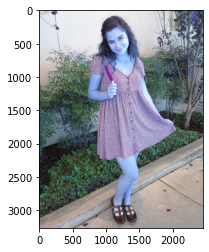

In [109]:
base_path = 'train/'

annotation = train_annotations[0]
coordinates = annotation['bbox']

im = cv2.imread(base_path+annotation['image_path'])
#Show the image with matplotlib
print(im.shape)
plt.imshow(im)
plt.show()

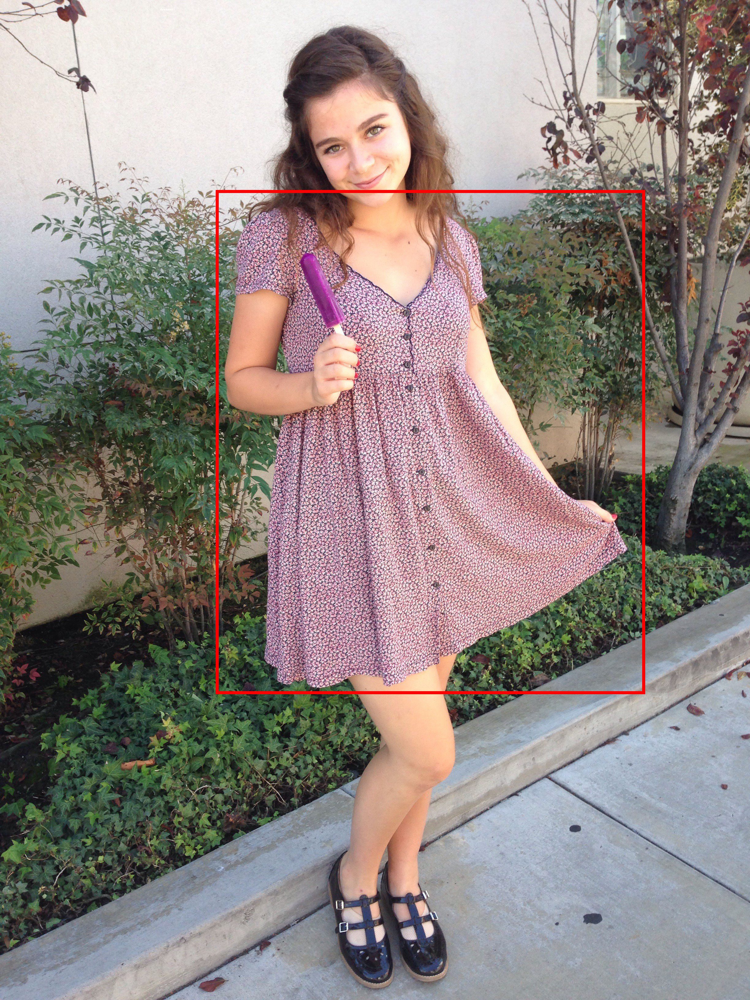

In [99]:
img = Image.open(base_path+annotation['image_path'])
# create rectangle image
img1 = ImageDraw.Draw(img)
img1.rectangle(((coordinates[0], coordinates[1]),(coordinates[0]+coordinates[2], coordinates[1]+coordinates[3])),  outline ="red",width=10)
img1.text((523,25), "dresses", fill=(255,255,255,128))
display(img)


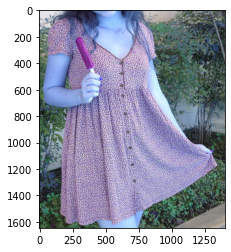

(1645, 1401, 3)


In [83]:
image = im[coordinates[1]:coordinates[1]+coordinates[3],coordinates[0]:coordinates[0]+coordinates[2]]

plt.imshow(image)
plt.show()
print(image.shape)

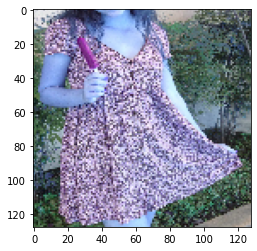

(128, 128, 3)


In [84]:
resized_image = cv2.resize(image, (128, 128),  
               interpolation = cv2.INTER_NEAREST) 

plt.imshow(resized_image)
plt.show()
print(resized_image.shape)

In [122]:
def visualize(original, aug):
    fig = plt.figure()
    plt.subplot(1,2,1)
    plt.title(annotation['cat'])
    plt.imshow(original)

    plt.subplot(1,2,2)
    plt.title(annotation['cat'] + ' flipped')
    plt.imshow(aug)

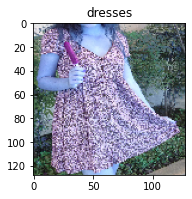

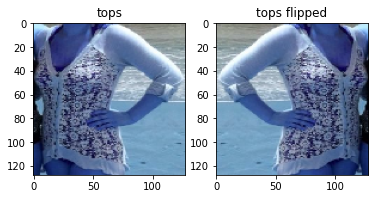

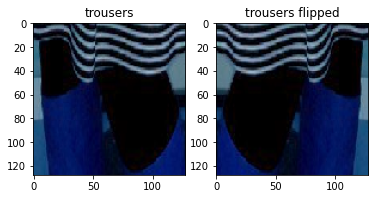

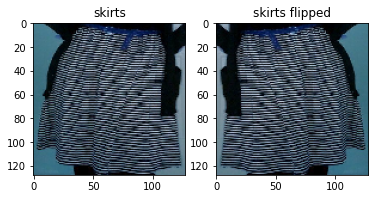

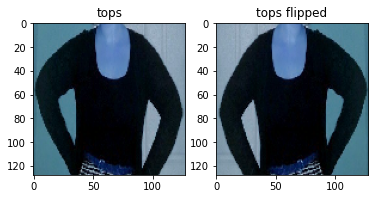

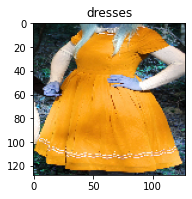

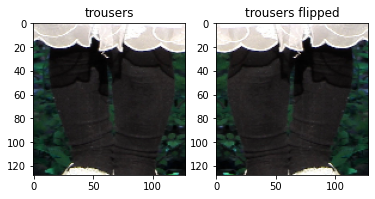

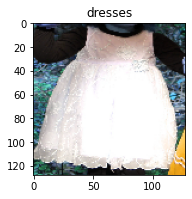

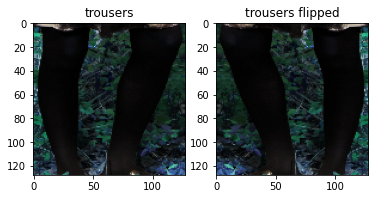

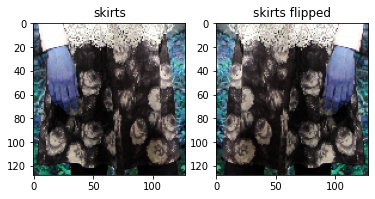

In [288]:
base_path = 'train/'

max_images = 10

for annotation in train_annotations[:max_images]:
    coordinates = annotation['bbox']
    
    x = coordinates[0]
    y = coordinates[1]
    width = coordinates[2]
    height = coordinates[3]

    im = cv2.imread(base_path+annotation['image_path'])
    image = im[y:y+height,x:x+width]
    
    resized_image = cv2.resize(image, (128, 128), interpolation = cv2.INTER_NEAREST) 

    if annotation['cat'] != 'dresses':
        aug = tf.image.flip_left_right(resized_image)
        visualize(resized_image, aug)     
                
    else:
        fig = plt.figure()
        plt.subplot(1,2,2)
        plt.title(annotation['cat'])
        plt.imshow(resized_image)
    
    #print(annotation['cat'])